# Clustering Task 1

## Installing and Loading Packages

In [1]:
# install.packages("plotly")
# install.packages("factoextra")
library(ggplot2)
library(plotly)
library(tidyverse)
library(dplyr)
library(ggplot2)
library(factoextra)


Attaching package: ‘plotly’


The following object is masked from ‘package:ggplot2’:

    last_plot


The following object is masked from ‘package:stats’:

    filter


The following object is masked from ‘package:graphics’:

    layout


── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ lubridate 1.9.3     ✔ tibble    3.2.1
✔ purrr     1.0.2     ✔ tidyr     1.3.1
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks plotly::filter(), stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
Welcome! Want to learn more? See two factoextra-related books at https://goo.gl/ve3WBa



## Loading Dataset

In [2]:
titles <- read.csv("titles.csv")
credits <- read.csv("credits.csv")

## Handling Missing Values

In [3]:
# Handle missing values (remove rows with missing key attributes)
cleaned_data <- titles %>%
  drop_na(release_year, runtime, imdb_score, imdb_votes, tmdb_popularity, tmdb_score)

In [4]:
print(paste("Number of rows after removing NA:", nrow(cleaned_data)))

[1] "Number of rows after removing NA: 5131"


In [5]:
# Remove rows where any of the specified columns have a value of 0
cleaned_data <- cleaned_data %>%
  filter(runtime != 0)

In [6]:
print(paste("Number of rows after removing NA:", nrow(cleaned_data)))

[1] "Number of rows after removing NA: 5123"


## Select Features for Clustering Algorithm

In [7]:
selected_columns <- c(
   'runtime','release_year' )
clustering_data <- cleaned_data[, selected_columns]

In [8]:
colnames(clustering_data)

[1] "runtime"      "release_year"

In [9]:
head(clustering_data)

,runtime,release_year
,<int>,<int>
1,114,1976
2,109,1972
3,91,1975
4,150,1967
5,30,1969
6,94,1979


## Normalize Selected Features

In [10]:
# Normalize selected features
clustering_data <- clustering_data %>%
  mutate(across(c(runtime,release_year), scale))

In [11]:
head(clustering_data)

,runtime,release_year
,"<dbl[,1]>","<dbl[,1]>"
1,0.9095741,-5.723907
2,0.7797696,-6.292254
3,0.3124734,-5.865994
4,1.8441665,-7.002687
5,-1.2711416,-6.718514
6,0.3903561,-5.297647


## Elbow Method to decide k value

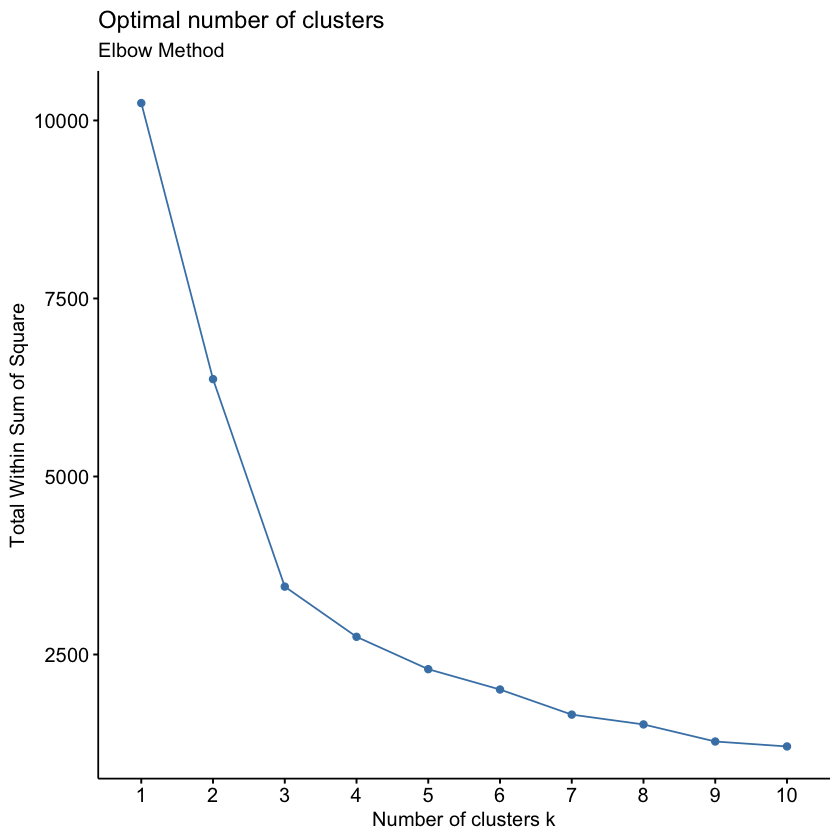

In [12]:
fviz_nbclust(clustering_data, kmeans, method = "wss") + labs(subtitle = "Elbow Method")

## Applying k means Clustering

In [13]:
# Kmeans
km.out <- kmeans(clustering_data, centers=3,nstart=100)
# print(km.out)

In [14]:
# Visualize the clustering algorithm results.
km.clusters<-km.out$cluster

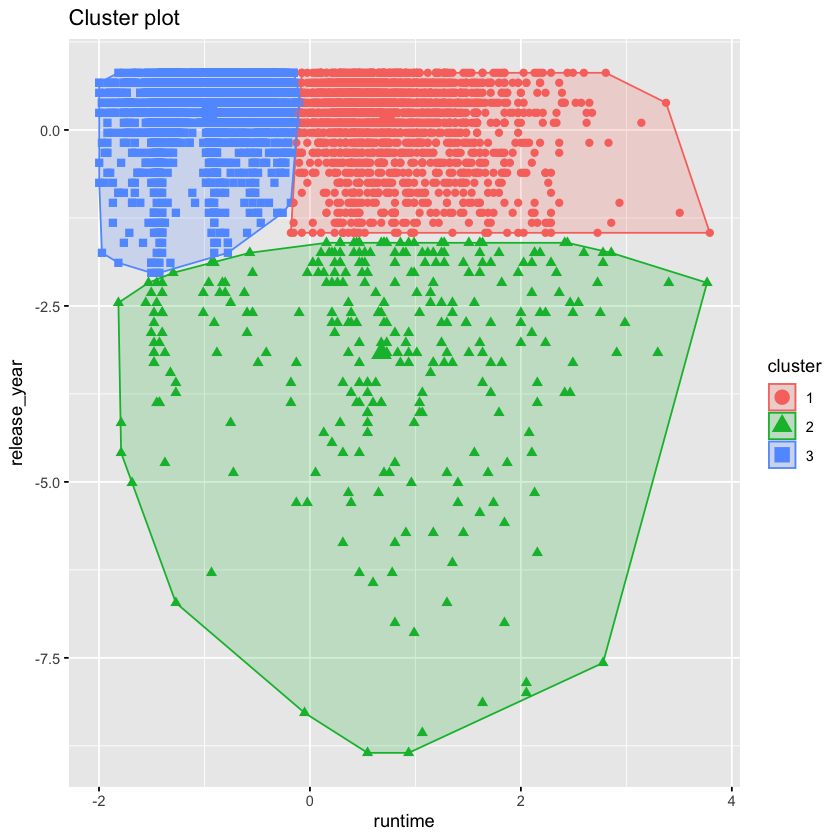

In [15]:
fviz_cluster(list(data=clustering_data, cluster=km.clusters),
             geom = "point",
             pointsize = 2)


## Interactive Plot

In [16]:
# Prepare the data
clustering_data$cluster <- factor(km.clusters)  # Add cluster labels
clustering_data$title <- cleaned_data$title  # Add title for hover info
clustering_data$genres <- cleaned_data$genres  # Add genres for hover info

# Create a combined text for hover
clustering_data$hover_info <- paste(
  "Title:", cleaned_data$title,
  "<br>Genre:", cleaned_data$genres,
  "<br>Release Year:", cleaned_data$release_year,
  "<br>Runtime:", cleaned_data$runtime
)

# Create a ggplot
p <- ggplot(clustering_data, aes(x = release_year, y = runtime, color = cluster, text = hover_info)) +
  geom_point(size = 2) +
  ggtitle("K-Means Clustering on Runtime and Release Year") +
  theme_minimal()

# Convert ggplot to interactive plotly
interactive_plot <- ggplotly(p, tooltip = "text")

# Display the interactive plot
interactive_plot


HTML widgets cannot be represented in plain text (need html)

# Clustering Task 2

## Loading Dataset

In [17]:
titles <- read.csv("titles.csv")
credits <- read.csv("credits.csv")

## Adding New Attributes

In [18]:
## Adding actor count
actors_only <- subset(credits, role == "ACTOR")

actor_counts <- actors_only %>%
  group_by(id) %>%
  summarise(actor_count = n())

titles <- titles %>%
  left_join(actor_counts, by = "id")

## Adding engagement score
titles$engagement_score <- (titles$imdb_score + titles$tmdb_score) / 2

## Adding genre count
titles$genre_count <- str_count(titles$genres, ",") + 1

In [19]:
colnames(titles)

[1] "id"                   "title"                "type"                
 [4] "description"          "release_year"         "age_certification"   
 [7] "runtime"              "genres"               "production_countries"
[10] "seasons"              "imdb_id"              "imdb_score"          
[13] "imdb_votes"           "tmdb_popularity"      "tmdb_score"          
[16] "actor_count"          "engagement_score"     "genre_count"

## Handling Missing Values

In [20]:
# Handle missing values (remove rows with missing key attributes)
cleaned_data <- titles %>%
  drop_na(release_year, runtime, imdb_score, imdb_votes, tmdb_popularity, tmdb_score, actor_count, engagement_score, genre_count)

In [21]:
print(paste("Number of rows after removing NA:", nrow(cleaned_data)))

[1] "Number of rows after removing NA: 4827"


In [22]:
# Remove rows where any of the specified columns have a value of 0
cleaned_data <- cleaned_data %>%
  filter(runtime != 0)

In [23]:
print(paste("Number of rows after removing NA:", nrow(cleaned_data)))

[1] "Number of rows after removing NA: 4820"


## Select Features for Clustering Algorithm

In [24]:
selected_columns <- c(
   'actor_count','engagement_score' )
clustering_data <- cleaned_data[, selected_columns]

In [25]:
colnames(clustering_data)

[1] "actor_count"      "engagement_score"

In [26]:
head(clustering_data)

,actor_count,engagement_score
,<int>,<dbl>
1,36,8.1895
2,22,7.5000
3,46,8.0055
4,54,7.6500
5,5,8.5530
6,21,7.9000


## Normalize Selected Features

In [27]:
# Normalize selected features
clustering_data <- clustering_data %>%
  mutate(across(c(actor_count,engagement_score), scale))

In [28]:
head(clustering_data)

,actor_count,engagement_score
,"<dbl[,1]>","<dbl[,1]>"
1,1.4183804,1.5181504
2,0.5039345,0.8368309
3,2.0715560,1.3363335
4,2.5940966,0.9850512
5,-0.6064641,1.8773378
6,0.4386169,1.2320852


## Elbow Method to decide k value

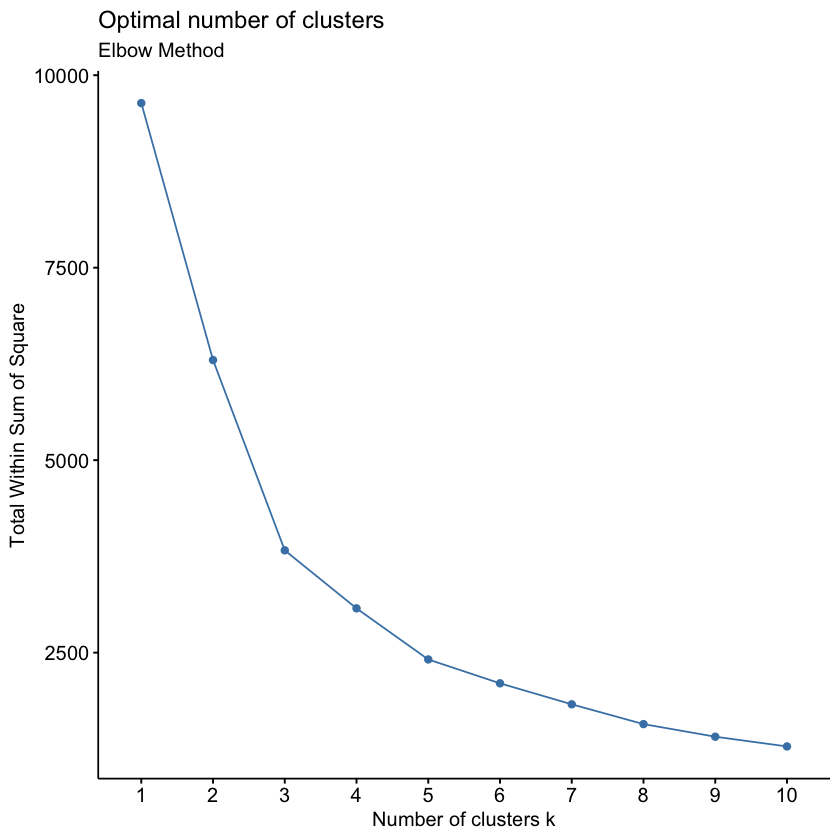

In [29]:
fviz_nbclust(clustering_data, kmeans, method = "wss") + labs(subtitle = "Elbow Method")

## Applying k means Clustering

In [30]:
# Kmeans
km.out <- kmeans(clustering_data, centers=3,nstart=100)
# print(km.out)

In [31]:
# Visualize the clustering algorithm results.
km.clusters<-km.out$cluster

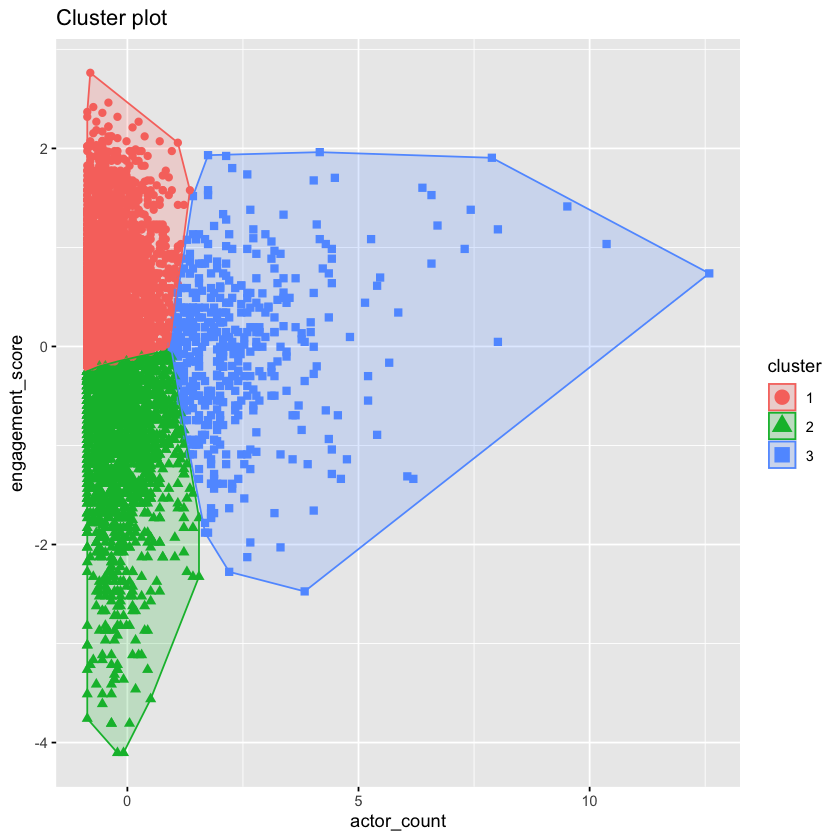

In [32]:
fviz_cluster(list(data=clustering_data, cluster=km.clusters),
             geom = "point",
             pointsize = 2)


## Interactive Plot

In [33]:
# Load necessary libraries
library(ggplot2)
library(plotly)

# Prepare the data
clustering_data$cluster <- factor(km.clusters)  # Add cluster labels
clustering_data$title <- cleaned_data$title  # Add title for hover info
clustering_data$genres <- cleaned_data$genres  # Add genres for hover info

# Create a combined text for hover
clustering_data$hover_info <- paste(
  "Title:", cleaned_data$title,
  "<br>Genre:", cleaned_data$genres,
  "<br>Actor Count:", cleaned_data$actor_count,
  "<br>Engagement Score:", cleaned_data$engagement_score
)

# Create a ggplot
p <- ggplot(clustering_data, aes(x = actor_count, y = engagement_score, color = cluster, text = hover_info)) +
  geom_point(size = 2) +
  ggtitle("K-Means Clustering on Actor Count and Engagement Score") +
  theme_minimal()

# Convert ggplot to interactive plotly
interactive_plot <- ggplotly(p, tooltip = "text")

# Display the interactive plot
interactive_plot

HTML widgets cannot be represented in plain text (need html)

# Clustering Task 3

## Loading Dataset

In [34]:
titles <- read.csv("titles.csv")
credits <- read.csv("credits.csv")

## Adding New Attributes

In [35]:
## Adding actor count
actors_only <- subset(credits, role == "ACTOR")

actor_counts <- actors_only %>%
  group_by(id) %>%
  summarise(actor_count = n())

titles <- titles %>%
  left_join(actor_counts, by = "id")

## Adding engagement score
titles$engagement_score <- (titles$imdb_score + titles$tmdb_score) / 2

## Adding genre count
titles$genre_count <- str_count(titles$genres, ",") + 1

## One Hot Encoding -> Genres

In [36]:
# Step 1: Remove square brackets and extra spaces, then split genres into lists
titles$genres <- gsub("\\[|\\]|'", "", titles$genres)
# print("After cleaning genres column:")
# print(titles$genres)

# Step 2: Split the genres column into a list of genres
titles$genres_list <- strsplit(titles$genres, ", ")
# print("After splitting genres into lists:")
# print(titles$genres_list)

# Step 3: Get unique genres across all entries
all_genres <- unique(unlist(titles$genres_list))
print("Unique genres across all entries:")
print(length(all_genres))
print(all_genres)

# Step 4: Create a new column for each genre (one-hot encoding)
for (genre in all_genres) {
  titles[[genre]] <- sapply(titles$genres_list, function(x) as.integer(genre %in% x))
}

# Remove the 'genres_list' column
titles_cleaned <- titles[, !names(titles) %in% "genres_list"]
titles <- titles_cleaned

[1] "Unique genres across all entries:"
[1] 19
 [1] "documentation" "drama"         "crime"         "action"       
 [5] "thriller"      "european"      "fantasy"       "comedy"       
 [9] "war"           "romance"       "western"       "history"      
[13] "music"         "family"        "horror"        "scifi"        
[17] "animation"     "reality"       "sport"        


## One Hot Encoding -> Countries

In [37]:
# Step 1: Remove square brackets and extra spaces, then split genres into lists
titles$production_countries <- gsub("\\[|\\]|'", "", titles$production_countries)
# print("After cleaning production_countries column:")
# print(titles$production_countries)

# Step 2: Split the production_countries column into a list of production_countries
titles$production_countries_list <- strsplit(titles$production_countries, ", ")
# print("After splitting production_countries into lists:")
# print(titles$production_countries_list)

# Step 3: Get unique production_countries across all entries
all_production_countries <- unique(unlist(titles$production_countries_list))
print("Unique production_countries across all entries:")
print(length(all_production_countries))
print(all_production_countries)

# Step 4: Create a new column for each production_countries (one-hot encoding)
for (production_countries in all_production_countries) {
  titles[[production_countries]] <- sapply(titles$production_countries_list, function(x) as.integer(production_countries %in% x))
}

# Remove the 'production_countries_list' column
titles_cleaned <- titles[, !names(titles) %in% "production_countries_list"]
titles <- titles_cleaned

[1] "Unique production_countries across all entries:"
[1] 109
  [1] "US"      "GB"      "EG"      "DE"      "IN"      "SU"      "LB"     
  [8] "CA"      "FR"      "DZ"      "IT"      "JP"      "AR"      "PE"     
 [15] "BR"      "IE"      "HK"      "AU"      "GH"      "BF"      "MX"     
 [22] "ES"      "CO"      "PS"      "NO"      "BE"      "TR"      "DK"     
 [29] "BS"      "CZ"      "MT"      "ZA"      "CN"      "BG"      "RU"     
 [36] "KR"      "CL"      "MA"      "UY"      "NL"      "SE"      "TW"     
 [43] "SG"      "NG"      "MY"      "Lebanon" "CH"      "PH"      "KW"     
 [50] "AT"      "XX"      "AE"      "HU"      "SA"      "ID"      "FI"     
 [57] "IL"      "CD"      "PL"      "VE"      "RO"      "IS"      "UA"     
 [64] "NZ"      "LU"      "IR"      "JO"      "QA"      "BY"      "HR"     
 [71] "SY"      "TN"      "GL"      "PT"      "PK"      "VN"      "PR"     
 [78] "IQ"      "TH"      "GE"      "KH"      "CU"      "KE"      "VA"     
 [85] "RS"      "TZ"      

## One Hot Encoding -> Age Certification

In [38]:
# Step 1: Get the unique age certification values (including the new category)
unique_certifications <- unique(titles$age_certification)
print("Unique age certifications after handling blanks:")
print(unique_certifications)

# Step 2: Create one-hot encoded columns
for (certification in unique_certifications) {
  # Create a binary column for each certification
  column_name <- paste("certification", certification, sep = "_")
  titles[[column_name]] <- ifelse(titles$age_certification == certification, 1, 0)
}


[1] "Unique age certifications after handling blanks:"
 [1] "TV-MA" "R"     "PG"    ""      "TV-14" "PG-13" "TV-PG" "TV-Y"  "TV-G" 
[10] "TV-Y7" "G"     "NC-17"


## Handling Missing Values

In [39]:
# Handle missing values (remove rows with missing key attributes)
cleaned_data <- titles %>%
  drop_na(release_year, runtime, imdb_score, imdb_votes, tmdb_popularity, tmdb_score, actor_count, engagement_score, genre_count)

In [40]:
print(paste("Number of rows after removing NA:", nrow(cleaned_data)))

[1] "Number of rows after removing NA: 4827"


## Select Features for Clustering Algorithm

In [41]:
# Select Features for Clustering Algorithm
selected_columns <- c(
  'release_year', 'runtime', 'documentation','drama','crime','action','thriller','european','fantasy','comedy','war','romance','western','history','music','family','horror','scifi','animation','reality','sport'#,'certification_TV-MA','certification_R','certification_PG','certification_','certification_TV-14','certification_PG-13','certification_TV-PG','certification_TV-Y','certification_TV-G','certification_TV-Y7','certification_G','certification_NC-17'
)
clustering_data <- cleaned_data[, selected_columns]

In [42]:
colnames(clustering_data)

[1] "release_year"  "runtime"       "documentation" "drama"        
 [5] "crime"         "action"        "thriller"      "european"     
 [9] "fantasy"       "comedy"        "war"           "romance"      
[13] "western"       "history"       "music"         "family"       
[17] "horror"        "scifi"         "animation"     "reality"      
[21] "sport"

## Normalize Selected Features

In [43]:
# Normalize selected features
clustering_data <- clustering_data %>%
  mutate(across(c(release_year, runtime,documentation,drama,crime,action,thriller,european,fantasy,comedy,war,romance,western,history,music,family,horror,scifi,animation,reality,sport), scale))

## Elbow Method to decide k value

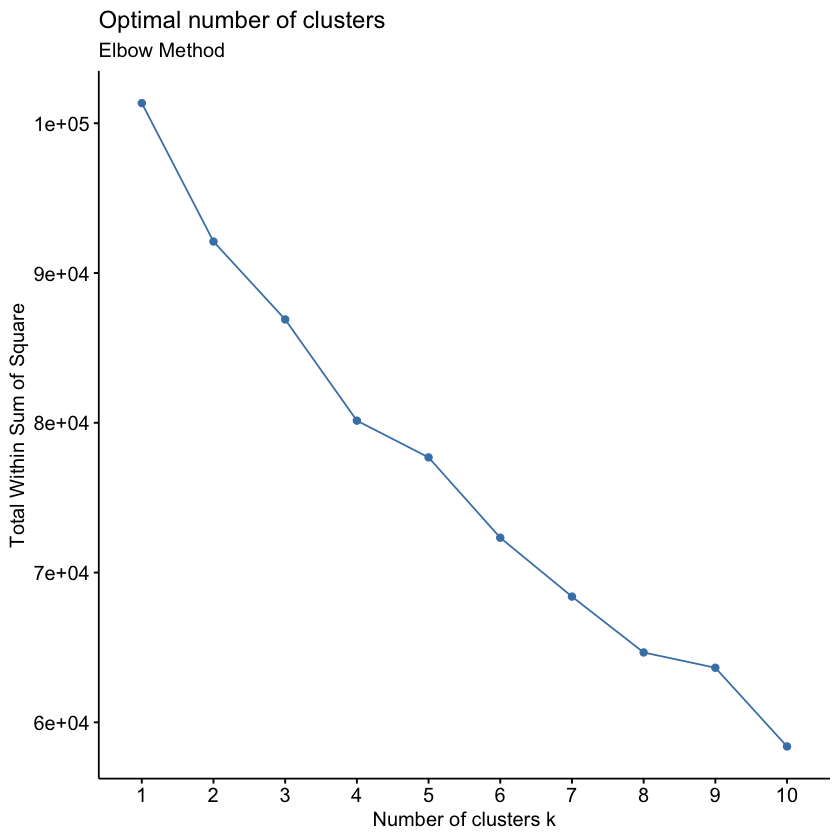

In [44]:
fviz_nbclust(clustering_data, kmeans, method = "wss") + labs(subtitle = "Elbow Method")

## Applying k means Clustering

In [45]:
# Kmeans
km.out <- kmeans(clustering_data, centers=19,nstart=100)
# print(km.out)

In [46]:
# Visualize the clustering algorithm results.
km.clusters<-km.out$cluster
# rownames(clustering_data)<-paste(cleaned_data$genres, 1:dim(cleaned_data)[1], sep = "_")

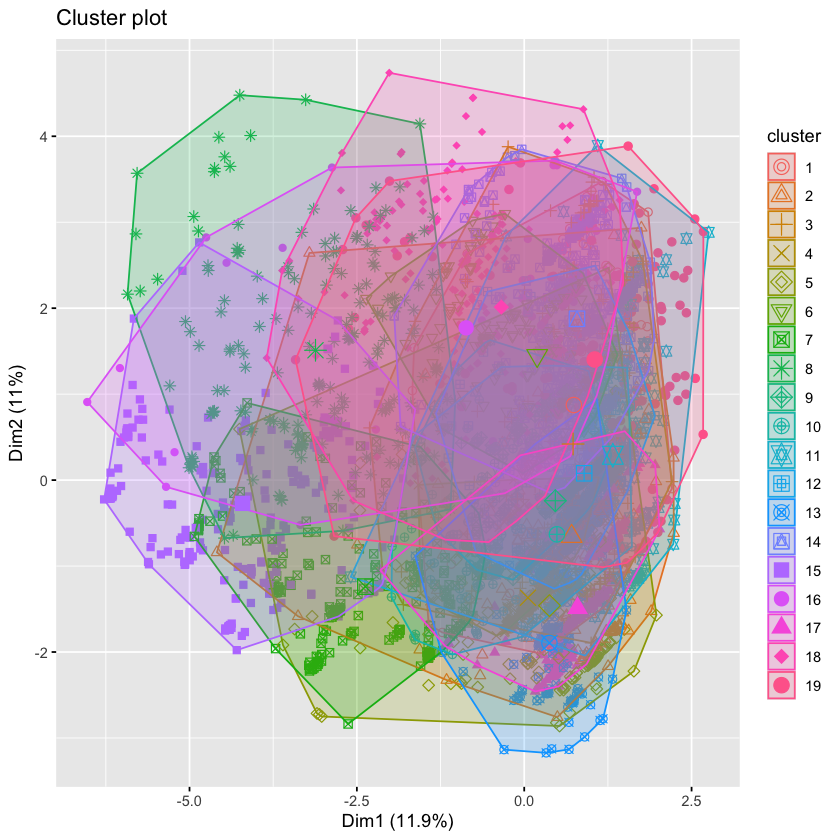

In [47]:
fviz_cluster(list(data=clustering_data, cluster=km.clusters),
             geom = "point",
             pointsize = 2)


## Interactive Plot

In [48]:
library(ggplot2)
library(plotly)

# Perform PCA to reduce dimensions to 2 for visualization
pca_result <- prcomp(clustering_data, center = TRUE, scale. = TRUE)
pca_data <- as.data.frame(pca_result$x[, 1:2])  # Keep only the first 2 principal components
colnames(pca_data) <- c("PC1", "PC2")

# Add cluster labels and genres for hover info
pca_data$cluster <- factor(km.clusters)
pca_data$genres <- cleaned_data$genres
pca_data$title <- cleaned_data$title
pca_data$release_year <- cleaned_data$release_year
pca_data$runtime <- cleaned_data$runtime
pca_data$age_certification <- cleaned_data$age_certification

# Create a combined text for hover
pca_data$hover_info <- paste("Title:", pca_data$title, "<br>Genre:", pca_data$genres, "<br>Release Year:", pca_data$release_year, "<br>Runtime:", pca_data$runtime, "<br>Age Certification:", pca_data$age_certification)

# Create a ggplot
p <- ggplot(pca_data, aes(x = PC1, y = PC2, color = cluster, text = hover_info)) +
  geom_point(size = 2) +
  ggtitle("K-Means Clustering with Genres") +
  theme_minimal()

# Convert ggplot to interactive plotly
interactive_plot <- ggplotly(p, tooltip = "text")

# Display the interactive plot
interactive_plot


HTML widgets cannot be represented in plain text (need html)